<a href="https://colab.research.google.com/github/raj-vijay/mv/blob/master/07_Lab_6_Feature_Tracking.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**BACKGROUND**

<p align = 'justify'>In Lecture 6 we looked at feature tracking. In this lab you will write a program to capture a video from the camera and track feature points in the video stream in real-time. If you do not have a camera, you can also do this exercise with the video bananas.mp4 available on Canvas.</p>

**Task 1**
<p align = 'justify'>Write a Python program for capturing a video stream from the camera. Convert each frame  into grayscale and extract a list of feature points from the first frame using  cv2.goodFeaturesToTrack(). Visualise the feature points in the image.</p>


**Task 2**

<p align = 'justify'>Calculate the optical flow for the extracted feature points using cv2.calcOpticalFlowPyrLK(). 
Update the feature points according to the optical flow and iterate over the video sequence. Discard features for which no optical flow could be calculated. Visualise the flow direction for the remaining features.</p>


**Task 3**

<p align = 'justify'>Regularly check how many features are still being tracked. If the number of tracked features falls below a threshold, use cv2. goodFeaturesToTrack() again to calculate new feature points. 
Fill up the features being tracked, but make sure that none of the replacement features is too close to an existing feature still being tracked.</p>

**Task 4**

<p align = 'justify'>Keep track of the history of all features being tracked and visualise the tracking paths of all currently visible features.</p>

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [2]:
from google.colab.patches import cv2_imshow

In [3]:
!wget https://github.com/raj-vijay/mv/raw/master/images/bananas.mp4

--2021-04-21 12:01:34--  https://github.com/raj-vijay/mv/raw/master/images/bananas.mp4
Resolving github.com (github.com)... 140.82.112.3
Connecting to github.com (github.com)|140.82.112.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/raj-vijay/mv/master/images/bananas.mp4 [following]
--2021-04-21 12:01:34--  https://raw.githubusercontent.com/raj-vijay/mv/master/images/bananas.mp4
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 6594680 (6.3M) [application/octet-stream]
Saving to: ‘bananas.mp4’

bananas.mp4         100%[===================>]   6.29M  --.-KB/s    in 0.07s   

2021-04-21 12:01:34 (96.6 MB/s) - ‘bananas.mp4’ saved [6594680/6594680]



In [4]:
def main():
    #cv2.namedWindow("camera")
    camera = cv2.VideoCapture('/content/bananas.mp4')

    # initialise features to track
    while camera.isOpened():
        ret,img= camera.read()        
        if ret:
            new_img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)        
            p0 = cv2.goodFeaturesToTrack(new_img, 200, 0.3, 7)                                    
            break    

    # initialise tracks
    index = np.arange(len(p0))
    tracks = {}
    for i in range(len(p0)):
        tracks[index[i]] = {0:p0[i]}
                
    frame = 0
    while camera.isOpened():
        ret,img= camera.read()                 
        if not ret:
            break

        frame += 1

        old_img = new_img
        new_img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)        

        # calculate optical flow
        if len(p0)>0: 
            p1, st, err  = cv2.calcOpticalFlowPyrLK(old_img, new_img, p0, None)                                    
            
            # visualise points
            for i in range(len(st)):
                if st[i]:
                    cv2.circle(img, (p1[i,0,0],p1[i,0,1]), 2, (0,0,255), 2)
                    cv2.line(img, (p0[i,0,0],p0[i,0,1]), (int(p0[i,0,0]+(p1[i][0,0]-p0[i,0,0])*5),int(p0[i,0,1]+(p1[i][0,1]-p0[i,0,1])*5)), (0,0,255), 2)            
            
            p0 = p1[st==1].reshape(-1,1,2)            
            index = index[st.flatten()==1]
                
            
        # refresh features, if too many lost
        if len(p0)<100:
            new_p0 = cv2.goodFeaturesToTrack(new_img, 200-len(p0), 0.3, 7)
            for i in range(len(new_p0)):
                if np.min(np.linalg.norm((p0 - new_p0[i]).reshape(len(p0),2),axis=1))>10:
                    p0 = np.append(p0,new_p0[i].reshape(-1,1,2),axis=0)
                    index = np.append(index,np.max(index)+1)

        # update tracks
        for i in range(len(p0)):
            if index[i] in tracks:
                tracks[index[i]][frame] = p0[i]
            else:
                tracks[index[i]] = {frame: p0[i]}

        # visualise last frames of active tracks
        for i in range(len(index)):
            for f in range(frame-20,frame):
                if (f in tracks[index[i]]) and (f+1 in tracks[index[i]]):
                    cv2.line(img,
                             (tracks[index[i]][f][0,0],tracks[index[i]][f][0,1]),
                             (tracks[index[i]][f+1][0,0],tracks[index[i]][f+1][0,1]), 
                             (0,255,0), 1)

        # cut tracks that are too long
        # for i in tracks:
        #     if len(tracks[i])>50:
        #         keys = list(tracks[i].keys())
        #         for j in keys:
        #             if j<=max(keys)-50:
        #                 del tracks[i][j]

        k = cv2.waitKey(1)
        if k%256 == 27:
            print("Escape hit, closing...")
            break
        
        cv2_imshow(img)            

 	
    A = np.zeros((max(index)+1,frame+1),dtype=np.uint8)
    for i in range(max(index)+1):
        for j in range(frame+1):
            if j in tracks[i]:
                A[i,j] = 1
    plt.imshow(A)
        
    return

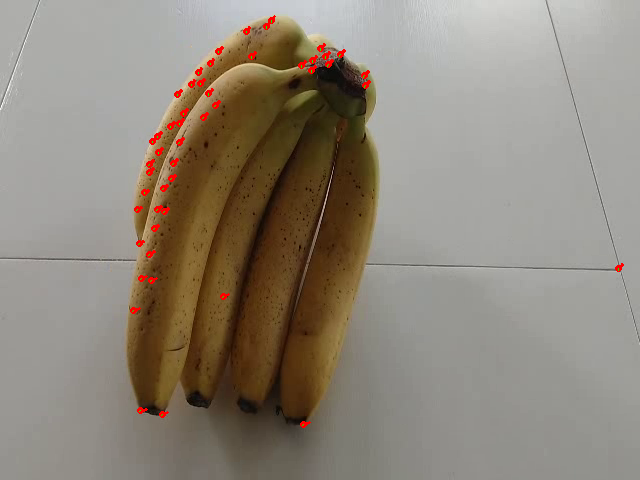

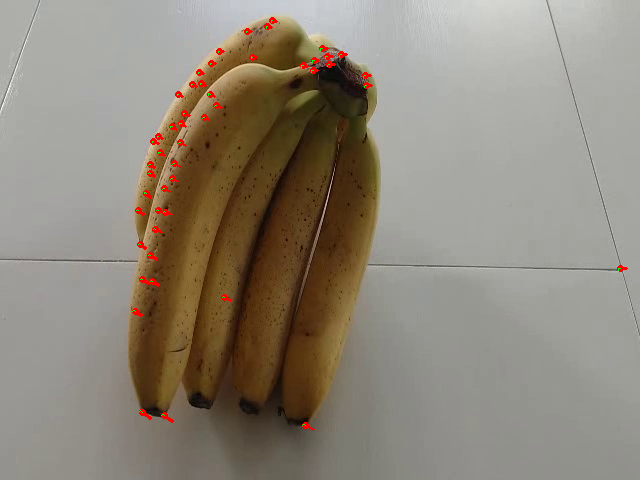

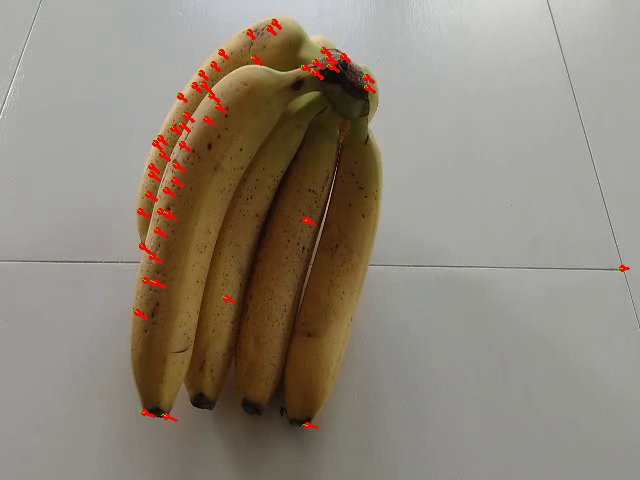

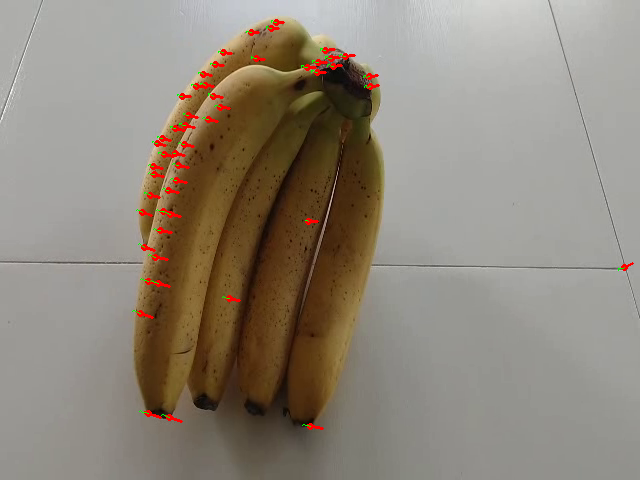

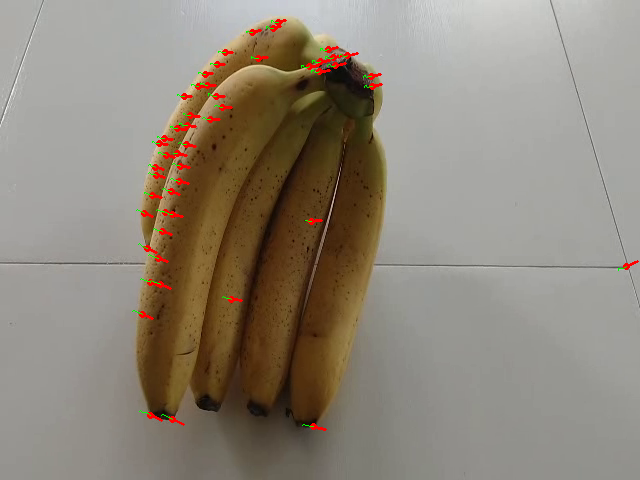

...

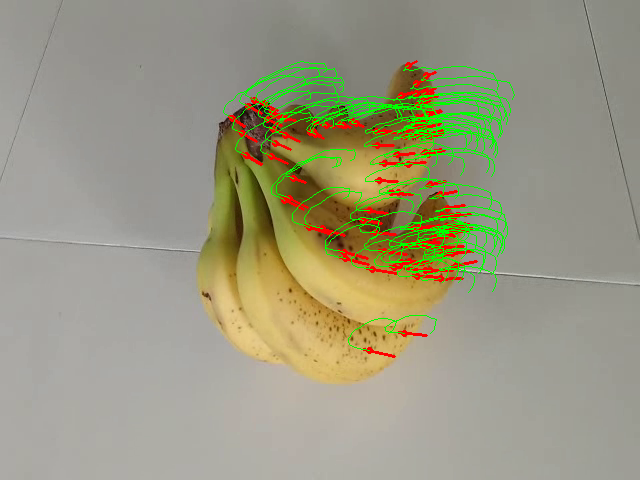

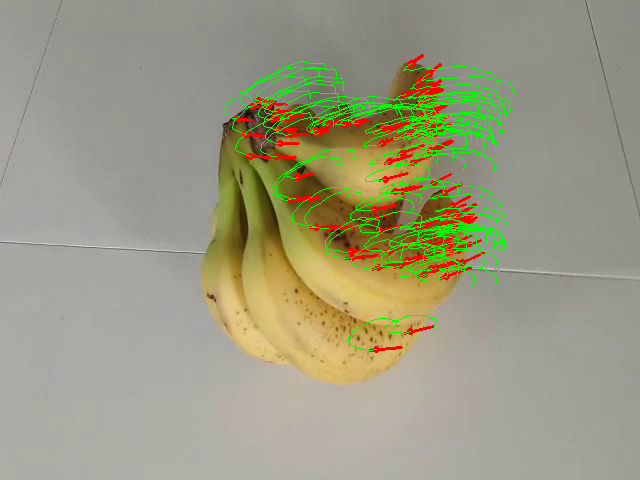

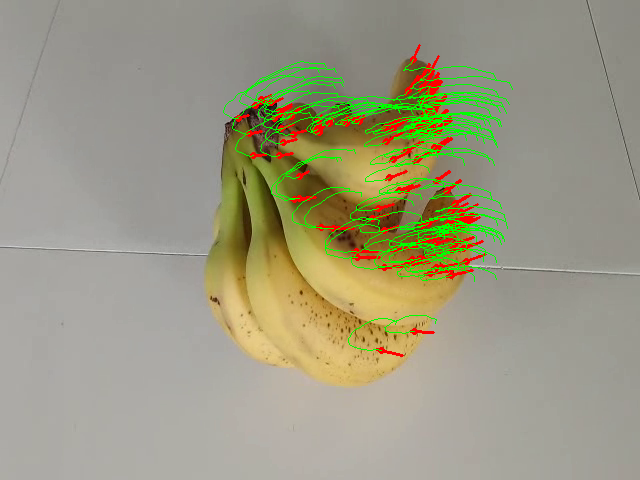

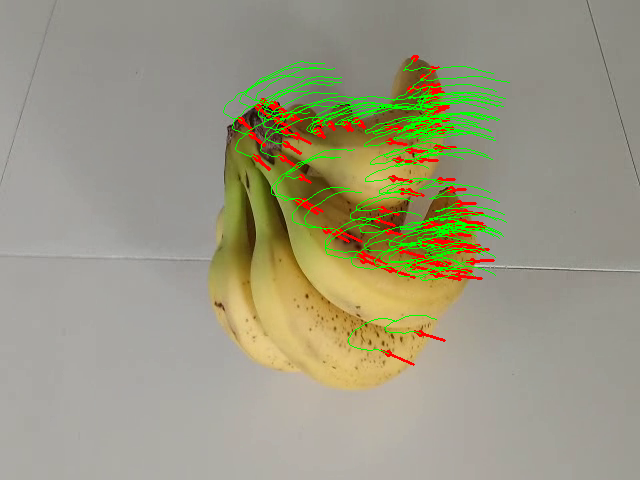

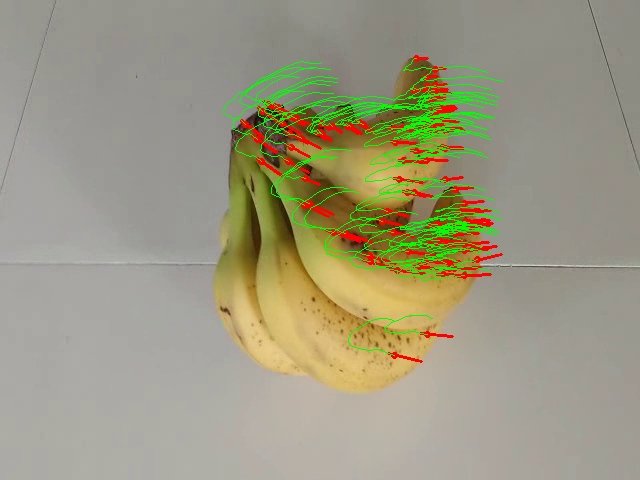

Buffered data was truncated after reaching the output size limit.

In [5]:
main()